In [46]:
import warnings
def showwarning(*args, **kwargs):
    if args[1] is DeprecationWarning:
        return
    warnings._showwarning_orig(*args, **kwargs)
warnings.showwarning = showwarning
import mglearn #library provided by amueller
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.model_selection import train_test_split
pd.options.display.float_format = '{:,.5g}'.format
import seaborn as sns
import time
from sklearn.metrics import accuracy_score
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

<span style="font-family:Georgia; font-size:28px; color:#333; text-decoration: underline;">Voice Gender Classification using Machine Learning Models</span>



<span style="font-family:Georgia; font-size:22px; color:#333">Problem Statement</span>

<span style="font-family:Georgia; font-size:12px; color:#333">Create a Machine Learning Model for Voice Gender Classification using Acoustic Properties</span>

<span style="font-family:Georgia; font-size:12px; color:#333">The objective is to develop a robust and computationally efficient model capable of accurately distinguishing between male and female speakers.</span>


<span style="font-family:Georgia; font-size:22px; color:#333">The Dataset</span>

<span style="font-family:Georgia; font-size:20px; color:#333">About the Dataset</span>

<span style="font-family:Georgia; font-size:12px; color:#333">The database is downloaded from
    https://www.kaggle.com/datasets/primaryobjects/voicegenderhttps://www.kaggle.com/datasets/primaryobjects/voicegender:</span>

<span style="font-family:Georgia; font-size:12px; color:#333">According to Kaggle, the database is from reputable repositories:</span>

- <span style="font-family:Georgia; font-size:12px; color:#333">Harvard-Haskins Database of Regularly-Timed Speech</span>
- <span style="font-family:Georgia; font-size:12px; color:#333">TSP Speech Database at McGill University</span>
- <span style="font-family:Georgia; font-size:12px; color:#333">VoxForge Speech Corpus</span>
- <span style="font-family:Georgia; font-size:12px; color:#333">Festvox CMU_ARCTIC Speech Database at Carnegie Mellon University</span>

<span style="font-family:Georgia; font-size:12px; color:#333"> These sources meticulously labeled each audio sample by gender and stored it as a .WAV file.</span>

<span style="font-family:Georgia; font-size:12px; color:#333">They analyzed the acoustic properties using the spectrographic analysis function from the WarbleR R package and extracted 22 acoustic parameters through preprocessing.
Warble R was primarily used to distinguish and classify bird vocalizations. </span>

<span style="font-family:Georgia; font-size:12px; color:#333">The resulting dataset comprises 3168 rows and 21 columns, including 20 features extracted from acoustic signals and 1 column for gender classification.</span>


<span style="font-family:Georgia; font-size:20px; color:#333">Attributes of the Dataset</span>

- <span style="font-family:Georgia; font-size:12px; color:#333"><code>meanfreq</code>: Mean frequency (in kHz)</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>sd</code>: Standard deviation of frequency</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>median</code>: Median frequency (in kHz)</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>Q25</code>: First quantile (in kHz)</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>Q75</code>: Third quantile (in kHz)</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>IQR</code>: Interquantile range (in kHz)</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>skew</code>: Skewness</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>kurt</code>: Kurtosis</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>sp.ent</code>: Spectral entropy</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>sfm</code>: Spectral flatness</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>mode</code>: Mode frequency</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>centroid</code>: Frequency centroid</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>peakf</code>: Peak frequency (frequency with highest energy)</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>meanfun</code>: Average fundamental frequency measured across acoustic signal</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>minfun</code>: Minimum fundamental frequency measured across acoustic signal</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>maxfun</code>: Maximum fundamental frequency measured across acoustic signal</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>meandom</code>: Average dominant frequency measured across acoustic signal</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>mindom</code>: Minimum dominant frequency measured across acoustic signal</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>maxdom</code>: Maximum dominant frequency measured across acoustic signal</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>dfrange</code>: Range of dominant frequency measured across acoustic signal</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>modindx</code>: Modulation index, calculated as the accumulated absolute difference between adjacent measurements of fundamental frequencies divided by the frequency range</span>
- <span style="font-family:Georgia; font-size:12px; color:#333"><code>label</code>: Male or Female</span>


<span style="font-family:Georgia; font-size:16px; color:#333;">Methodology</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">The methodology involves several key steps:</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">1. **Data Collection**: We source data from reputable repositories, ensuring its quality and relevance to our study.</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">2. **Preprocessing and Exploratory Data Analysis**: The data undergoes thorough preprocessing to clean it and prepare it for analysis. This includes handling missing values, standardizing features, and addressing any outliers.</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">3. **Model Selection**: We explore various machine learning models, considering their suitability for our task, and select the most appropriate ones based on performance metrics and validation results. This study employed grid search to find the best ML parameters for each model. Models used are the following:</span>

- <span style="font-family:Georgia; font-size:12px; color:#333;">Logistic Regression</span>
- <span style="font-family:Georgia; font-size:12px; color:#333;">Decision Tree</span>
- <span style="font-family:Georgia; font-size:12px; color:#333;">Random Forest</span>
- <span style="font-family:Georgia; font-size:12px; color:#333;">Gradient Boosting</span>
- <span style="font-family:Georgia; font-size:12px; color:#333;">Support Vector Machine</span>
- <span style="font-family:Georgia; font-size:12px; color:#333;">k Nearest Neighbors Classifier</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">4. **Training and Evaluation**: The selected models are trained on the preprocessed data and evaluated using appropriate evaluation metrics to assess their performance in classifying voice gender accurately.This studfy used 80-20 split in the train-test dataset</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">5. **Feature Selection**: We evaluate feature importance to determine the most relevant features for voice gender classification.</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">6. **Optimization**: We fine-tune the parameters of the chosen models to improve their performance further if necessary.</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">This structured approach ensures a robust and systematic methodology for voice gender classification using machine learning.</span>




<span style="font-family:Georgia; font-size:20px; color:#333">Data Preprocessing and Exploratory Data Analysis</span>

<span style="font-family:Georgia; font-size:12px; color:#333">The data is relatively clean and has undergone general preprocessing. There are no null values present, and each category has an equal number of observations.</span>

In [89]:
# Reading the file.

voice_df = pd.read_csv('voice.csv')
voice_df

,meanfreq,sd,median,Q25,Q75,IQR,skew,kurt,sp.ent,sfm,...,centroid,meanfun,minfun,maxfun,meandom,mindom,maxdom,dfrange,modindx,label
0,0.059781,0.064241,0.032027,0.015071,0.090193,0.075122,12.863,274.4,0.89337,0.49192,...,0.059781,0.084279,0.015702,0.27586,0.0078125,0.0078125,0.0078125,0,0,male
1,0.066009,0.06731,0.040229,0.019414,0.092666,0.073252,22.423,634.61,0.89219,0.51372,...,0.066009,0.10794,0.015826,0.25,0.0090144,0.0078125,0.054688,0.046875,0.052632,male
2,0.077316,0.083829,0.036718,0.0087011,0.13191,0.12321,30.757,"1,024.9",0.84639,0.4789,...,0.077316,0.098706,0.015656,0.27119,0.0079901,0.0078125,0.015625,0.0078125,0.046512,male
3,0.15123,0.072111,0.15801,0.096582,0.20796,0.11137,1.2328,4.1773,0.96332,0.72723,...,0.15123,0.088965,0.017798,0.25,0.2015,0.0078125,0.5625,0.55469,0.24712,male
4,0.13512,0.079146,0.12466,0.07872,0.20604,0.12732,1.1012,4.3337,0.97196,0.78357,...,0.13512,0.1064,0.016931,0.26667,0.71281,0.0078125,5.4844,5.4766,0.20827,male
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3163,0.13188,0.084734,0.15371,0.049285,0.20114,0.15186,1.7621,6.6304,0.96293,0.76318,...,0.13188,0.18279,0.08377,0.2623,0.8329,0.0078125,4.2109,4.2031,0.16193,female
3164,0.11622,0.089221,0.076758,0.042718,0.20491,0.16219,0.69373,2.504,0.96072,0.70957,...,0.11622,0.18898,0.034409,0.27586,0.90986,0.039062,3.6797,3.6406,0.2779,female
3165,0.14206,0.095798,0.18373,0.033424,0.22436,0.19094,1.8765,6.6045,0.94685,0.6542,...,0.14206,0.20992,0.039506,0.27586,0.49427,0.0078125,2.9375,2.9297,0.19476,female
3166,0.14366,0.090628,0.18498,0.043508,0.21994,0.17643,1.5911,5.3883,0.95044,0.67547,...,0.14366,0.17237,0.034483,0.25,0.79136,0.0078125,3.5938,3.5859,0.311,female


In [92]:
# Checking for null values:
voice_df.isnull().sum()

meanfreq    0
sd          0
median      0
Q25         0
Q75         0
IQR         0
skew        0
kurt        0
sp.ent      0
sfm         0
mode        0
centroid    0
meanfun     0
minfun      0
maxfun      0
meandom     0
mindom      0
maxdom      0
dfrange     0
modindx     0
label       0
dtype: int64

In [93]:
# Cheking the shape
voice_df.shape

(3168, 21)

In [94]:
# Chekng features.
voice_df.columns

Index(['meanfreq', 'sd', 'median', 'Q25', 'Q75', 'IQR', 'skew', 'kurt',
       'sp.ent', 'sfm', 'mode', 'centroid', 'meanfun', 'minfun', 'maxfun',
       'meandom', 'mindom', 'maxdom', 'dfrange', 'modindx', 'label'],
      dtype='object')

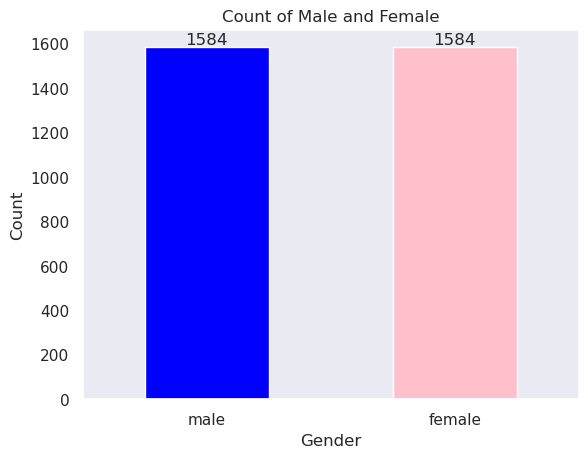

In [96]:
# Counting occurrences of 'male' and 'female'
gender_counts = voice_df['label'].value_counts()

# Plotting the counts
gender_counts.plot(kind='bar', color=['blue', 'pink'])  # Choosing colors for male and female
plt.title('Count of Male and Female')
plt.xlabel('Gender')
plt.ylabel('Count')
plt.xticks(rotation=0)  # Rotate x-axis labels if necessary

# Adding data point labels
for i, count in enumerate(gender_counts):
    plt.text(i, count, str(count), ha='center', va='bottom')

plt.grid(False)
plt.show()

Data seems is equally distributed between male and female

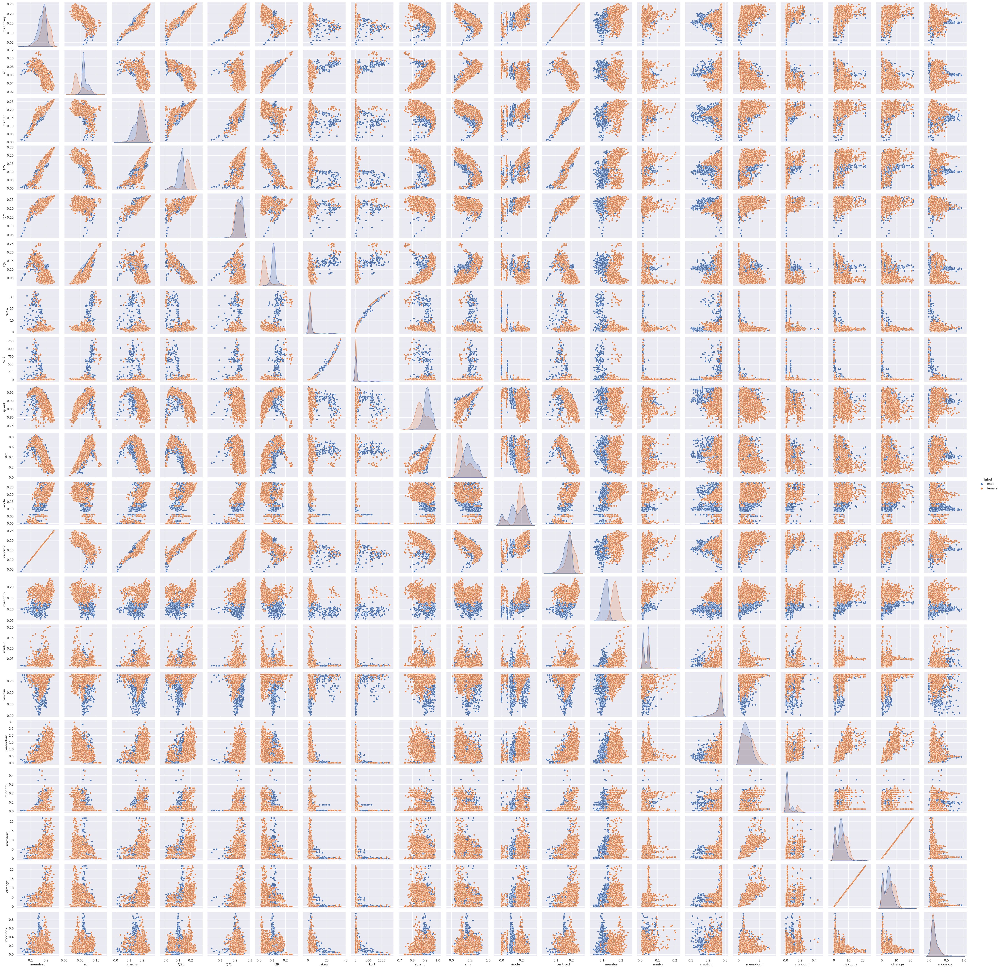

In [98]:
# Checking pairwise the features.
sns.set(style="darkgrid") #whitegrid, ticks 
sns.pairplot(voice_df, hue="label");

<span style="font-family:Georgia; font-size:20px; color:#333">Model Selection, Model Training and Testing</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">We begin by establishing a base case scenario using all features. A code is developed to simultaneously run the mentioned classifier models and utilize grid search to tune the hyperparameters. The results are summarized below:</span>


In [78]:
# Separate the data into features and targets
# Define features and target variable
X = voice_df.drop(columns=['label'])  # Drop the target column
y = voice_df['label']  # Target column

# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [79]:
# Define a list of classification models with their hyperparameters grid
models = [
    ('Logistic Regression', LogisticRegression(max_iter=5000), {'C': [0.1, 1, 10]}),
    ('Decision Tree', DecisionTreeClassifier(), {'max_depth': [None, 5, 10]}),
    ('Random Forest', RandomForestClassifier(), {'n_estimators': [50, 100, 200]}),
    ('Gradient Boosting', GradientBoostingClassifier(), {'n_estimators': [50, 100, 200], 'learning_rate': [0.01, 0.1, 1.0]}),
    ('Support Vector Machine', SVC(), {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']}),
    ('K-Nearest Neighbors', KNeighborsClassifier(), {'n_neighbors': [3, 5, 7]})
]

# Initialize a list to store the results
results = []

# Define a function to perform grid search and evaluate each model
def train_and_evaluate_model(model, param_grid, X_train, X_test, y_train, y_test):
    start_time = time.time()
    grid_search = GridSearchCV(model, param_grid, cv=5, n_jobs=-1)
    grid_search.fit(X_train, y_train)
    train_accuracy = accuracy_score(y_train, grid_search.predict(X_train))
    test_accuracy = accuracy_score(y_test, grid_search.predict(X_test))
    run_time = time.time() - start_time
    best_params = grid_search.best_params_
    return train_accuracy, test_accuracy, run_time, best_params

In [80]:
# Iterate over each model, perform grid search, train, evaluate, and store results
for model_name, model, param_grid in models:
    train_accuracy, test_accuracy, run_time, best_params = train_and_evaluate_model(model, param_grid, X_train, X_test, y_train, y_test)
    results.append((model_name, train_accuracy, test_accuracy, run_time, best_params))

# Create a DataFrame to store the results
df_results = pd.DataFrame(results, columns=['Model', 'Train Accuracy', 'Test Accuracy', 'Run Time', 'Best Parameters'])

# Display the results DataFrame
df_results

,Model,Train Accuracy,Test Accuracy,Run Time,Best Parameters
0,Logistic Regression,0.96093,0.97792,9.7081,{'C': 10}
1,Decision Tree,0.98698,0.96215,0.47579,{'max_depth': 5}
2,Random Forest,1,0.98423,4.9871,{'n_estimators': 200}
3,Gradient Boosting,1,0.98265,27.934,"{'learning_rate': 1.0, 'n_estimators': 200}"
4,Support Vector Machine,0.97119,0.98423,55.117,"{'C': 10, 'kernel': 'linear'}"
5,K-Nearest Neighbors,0.81018,0.70505,0.45978,{'n_neighbors': 5}


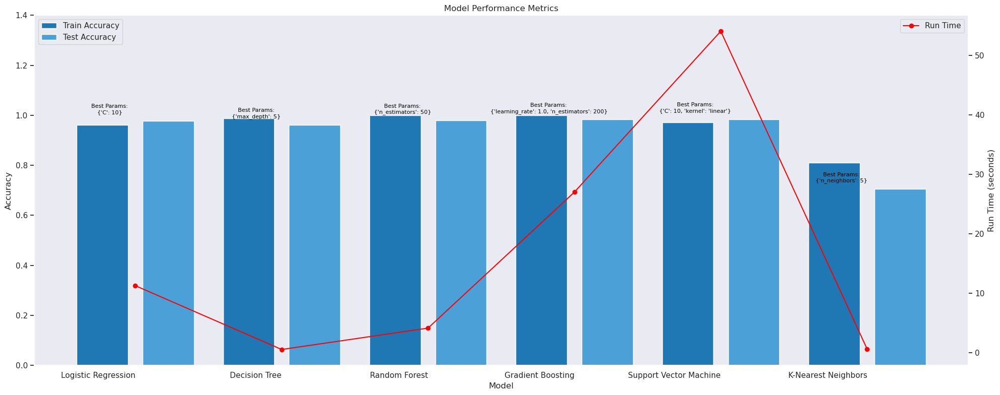

In [43]:
# Extract data for plotting
models = df_results['Model']
train_accuracy = df_results['Train Accuracy']
test_accuracy = df_results['Test Accuracy']
run_time = df_results['Run Time']
best_params = df_results['Best Parameters']

# Create subplots
fig, ax1 = plt.subplots(figsize=(20, 8))

# Plot train and test accuracy
bar_width = 0.35
index = np.arange(len(models))

train_bars = ax1.bar(index - bar_width/2 - 0.05, train_accuracy, bar_width, color='#1f77b4', label='Train Accuracy')  # Light blue
test_bars = ax1.bar(index + bar_width/2 + 0.05, test_accuracy, bar_width, color='#4ba0d8', label='Test Accuracy')  # Darker blue

ax1.set_xlabel('Model')
ax1.set_ylabel('Accuracy')
ax1.set_ylim(0, 1.4)  # Set y-axis range for accuracy
ax1.set_title('Model Performance Metrics')
ax1.set_xticks(index)
ax1.set_xticklabels(models, rotation=0, ha='right')
ax1.legend(loc='upper left')

# Create secondary axis for run time
ax2 = ax1.twinx()
run_time_line = ax2.plot(index, run_time, color='red', marker='o', label='Run Time')  # Green color

ax2.set_ylabel('Run Time (seconds)')
ax2.legend(loc='upper right')

# Remove gridlines
ax1.grid(False)
ax2.grid(False)

# Annotate best parameters inside the bars
for i, model_name in enumerate(models):
    ax1.annotate(f"Best Params:\n{best_params[i]}", (index[i] - bar_width/2, test_accuracy[i]), xytext=(0, 10), textcoords='offset points', ha='center', fontsize=8, color='black')

plt.tight_layout()
plt.show()

<span style="font-family:Georgia; font-size:20px; color:#333">Feature Analysis and Selection</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">Our analysis indicates that the majority of the models perform well, with the exception of kNN. Subsequently, we investigate the importance of features to determine if further optimization of our ML models is possible by removing nonsignificant features.</span>


In [65]:
from sklearn.inspection import permutation_importance

# Convert string labels to numerical values using label encoding
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Initialize a dictionary to store feature importances for each model
feature_importances_dict = {}

# Initialize the models
models = {
    'Logistic Regression': LogisticRegression(),
    'Decision Tree': DecisionTreeClassifier(),
    'Random Forest': RandomForestClassifier(n_estimators=100, random_state=42),
    'Gradient Boosting': GradientBoostingClassifier(),
    'Support Vector Machine': SVC(),
    'K-Nearest Neighbors': KNeighborsClassifier()
}

for model_name, model in models.items():
    # Fit the model
    model.fit(X, y)
    
    # Calculate permutation importance
    result = permutation_importance(model, X, y, n_repeats=10, random_state=42)
    feature_importances = result.importances_mean
    
    # Store feature importances in the dictionary
    feature_importances_dict[model_name] = pd.Series(feature_importances, index=X.columns)

# Create a DataFrame to store feature importances for all models
feature_importances_df = pd.DataFrame(feature_importances_dict)

# Display the top features for each model
print("Top features for each model:")
for model_name in feature_importances_df.columns:
    top_features = feature_importances_df[model_name].sort_values(ascending=False).head(5)
    print(f"{model_name}:")
    print(top_features)
    print()

Top features for each model:
Logistic Regression:
maxdom     0.25764
dfrange    0.15167
skew      0.079009
meanfun   0.038763
kurt      0.034533
Name: Logistic Regression, dtype: float64

Decision Tree:
meanfun     0.39293
IQR         0.11929
sp.ent     0.058428
minfun     0.016319
sfm       0.0098801
Name: Decision Tree, dtype: float64

Random Forest:
meanfun     0.25688
IQR        0.055492
Q25       0.0029987
sfm       0.0020518
dfrange   0.0010732
Name: Random Forest, dtype: float64

Gradient Boosting:
meanfun     0.29826
IQR        0.098927
sfm       0.0084912
modindx   0.0083333
minfun    0.0051768
Name: Gradient Boosting, dtype: float64

Support Vector Machine:
kurt       0.090246
maxdom     0.053914
dfrange    0.050537
skew      0.0077967
meandom   0.0012311
Name: Support Vector Machine, dtype: float64

K-Nearest Neighbors:
kurt       0.16528
maxdom      0.1589
dfrange    0.12607
skew       0.10524
meandom   0.035069
Name: K-Nearest Neighbors, dtype: float64



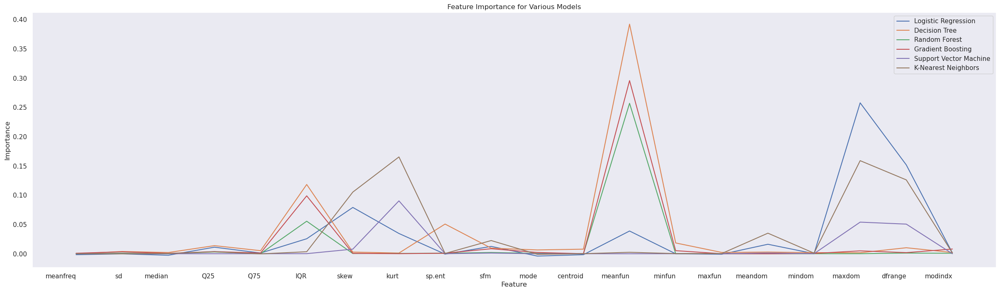

In [58]:
# Plot feature importances for each model
plt.figure(figsize=(30, 8))
for model_name in feature_importances_df.columns:
    plt.plot(feature_importances_df[model_name], label=model_name)  # Remove gridlines

plt.xlabel('Feature')
plt.ylabel('Importance')
plt.title('Feature Importance for Various Models')
plt.xticks(rotation=0, ha='right')
plt.legend()

# Remove gridlines
plt.grid(False)

plt.show()

<span style="font-family:Georgia; font-size:12px; color:#333;">In our analysis, we find that the following features are deemed important to the models: IQR, skew, kurt, sp.ent, sfm, meanfun, meandom, maxdom, and dfrange.We will investigate further if dropping all other features will result in increased model accuracy and efficiency.</span>

<span style="font-family:Georgia; font-size:20px; color:#333">Optimization</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">After retaining only significant features and runing the ML models again, we can see slight improvement in the accuracy and runtimes except for SVM.</span>

In [ ]:
# Dropping other features to simplify the model and evaluating the resulting dataframe
# Use only IQR, skew, kurt, sp.ent, sfm, meanfun, meandom, max dom, dfrange

In [70]:
# Separate the data into features and targets
# Define features and target variable
Xnew = voice_df.drop(columns=['meanfreq', 'sd', 'median', 'Q25', 'Q75', 'mode', 'centroid','minfun', 'maxfun', 'mindom', 'modindx','label'])  # Drop the target column
ynew = voice_df['label']  # Target column

# Split the data into train and test sets
X_train_new, X_test_new, y_train_new, y_test_new = train_test_split(Xnew, ynew, test_size=0.2, random_state=42)

In [76]:
# Define a list of classification models with their hyperparameters grid
models = [
    ('Logistic Regression', LogisticRegression(max_iter=5000), {'C': [0.1, 1, 10]}),
    ('Decision Tree', DecisionTreeClassifier(), {'max_depth': [None, 5, 10]}),
    ('Random Forest', RandomForestClassifier(), {'n_estimators': [50, 100, 200]}),
    ('Gradient Boosting', GradientBoostingClassifier(), {'n_estimators': [50, 100, 200], 'learning_rate': [0.01, 0.1, 1.0]}),
    ('Support Vector Machine', SVC(), {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']}),
    ('K-Nearest Neighbors', KNeighborsClassifier(), {'n_neighbors': [3, 5, 7]})
]

# Initialize a list to store the results
results_new = []


# Iterate over each model, perform grid search, train, evaluate, and store results
for model_name, model, param_grid in models:
    train_accuracy, test_accuracy, run_time, best_params = train_and_evaluate_model(model, param_grid, X_train_new, X_test_new, y_train_new, y_test_new)
    results_new.append((model_name, train_accuracy, test_accuracy, run_time, best_params))

# Create a DataFrame to store the results
df_results_new = pd.DataFrame(results_new, columns=['Model', 'Train Accuracy', 'Test Accuracy', 'Run Time', 'Best Parameters'])

# Display the results DataFrame
df_results_new

,Model,Train Accuracy,Test Accuracy,Run Time,Best Parameters
0,Logistic Regression,0.96093,0.97634,4.2047,{'C': 10}
1,Decision Tree,0.9854,0.9653,0.30992,{'max_depth': 5}
2,Random Forest,1,0.97476,4.1546,{'n_estimators': 200}
3,Gradient Boosting,0.99961,0.97792,14.675,"{'learning_rate': 0.1, 'n_estimators': 200}"
4,Support Vector Machine,0.96606,0.98107,88.238,"{'C': 10, 'kernel': 'linear'}"
5,K-Nearest Neighbors,0.80624,0.7082,0.4502,{'n_neighbors': 5}


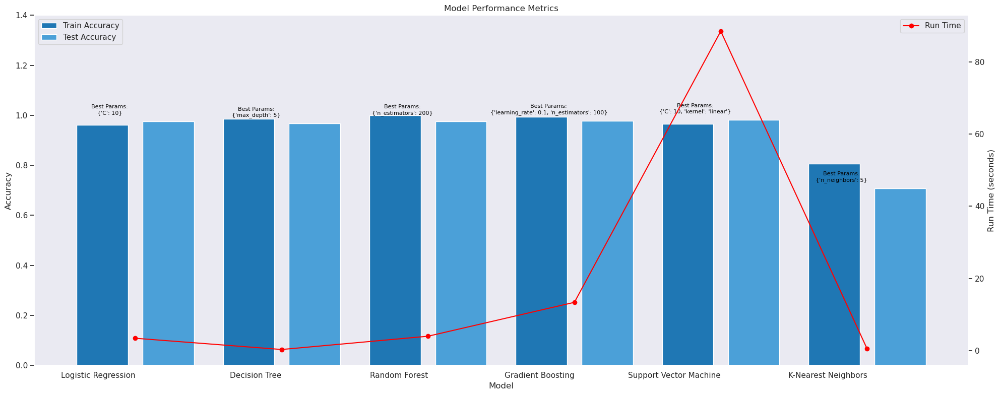

In [72]:
# Extract data for plotting
models = df_results_new['Model']
train_accuracy = df_results_new['Train Accuracy']
test_accuracy = df_results_new['Test Accuracy']
run_time = df_results_new['Run Time']
best_params = df_results_new['Best Parameters']

# Create subplots
fig, ax1 = plt.subplots(figsize=(20, 8))

# Plot train and test accuracy
bar_width = 0.35
index = np.arange(len(models))

train_bars = ax1.bar(index - bar_width/2 - 0.05, train_accuracy, bar_width, color='#1f77b4', label='Train Accuracy')  # Light blue
test_bars = ax1.bar(index + bar_width/2 + 0.05, test_accuracy, bar_width, color='#4ba0d8', label='Test Accuracy')  # Darker blue

ax1.set_xlabel('Model')
ax1.set_ylabel('Accuracy')
ax1.set_ylim(0, 1.4)  # Set y-axis range for accuracy
ax1.set_title('Model Performance Metrics')
ax1.set_xticks(index)
ax1.set_xticklabels(models, rotation=0, ha='right')
ax1.legend(loc='upper left')

# Create secondary axis for run time
ax2 = ax1.twinx()
run_time_line = ax2.plot(index, run_time, color='red', marker='o', label='Run Time')  # Green color

ax2.set_ylabel('Run Time (seconds)')
ax2.legend(loc='upper right')

# Remove gridlines
ax1.grid(False)
ax2.grid(False)

# Annotate best parameters inside the bars
for i, model_name in enumerate(models):
    ax1.annotate(f"Best Params:\n{best_params[i]}", (index[i] - bar_width/2, test_accuracy[i]), xytext=(0, 10), textcoords='offset points', ha='center', fontsize=8, color='black')

plt.tight_layout()
plt.show()

In [73]:
voice_df_new = voice_df.drop(columns=['meanfreq', 'sd', 'median', 'Q25', 'Q75', 'mode', 'centroid', 'minfun','maxfun', 'mindom', 'modindx'])

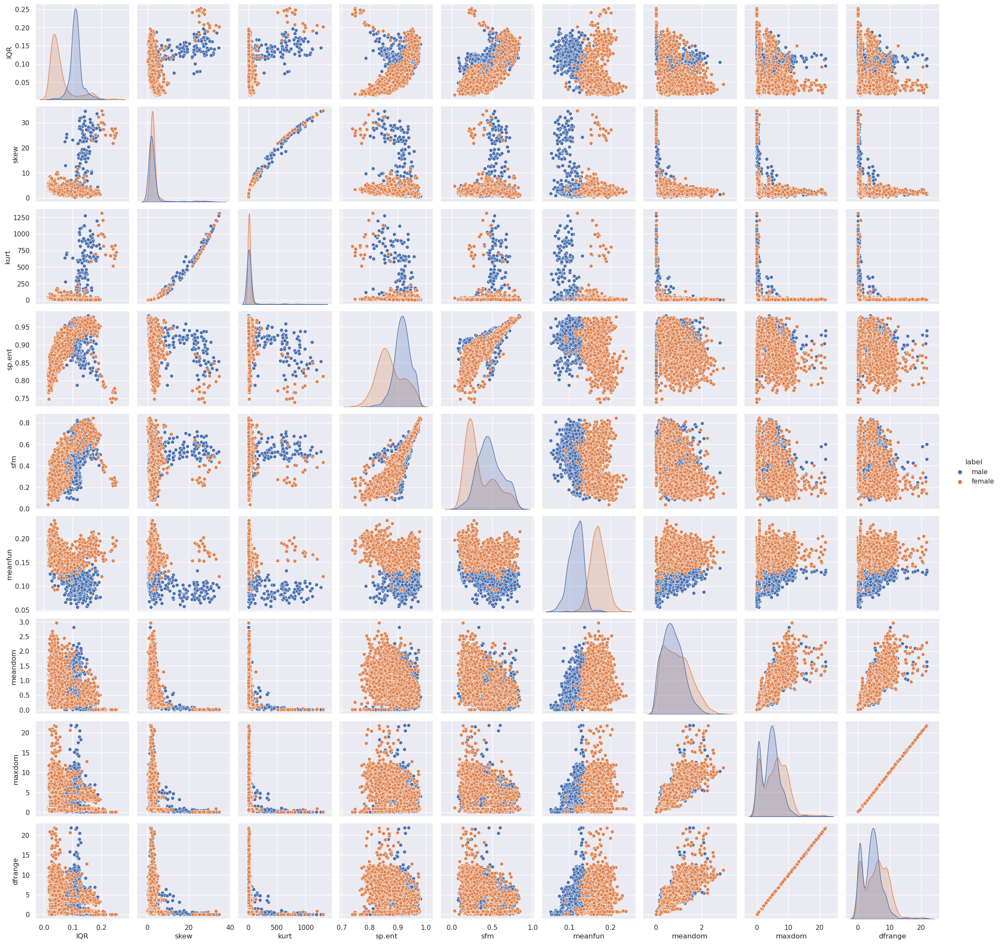

In [74]:
sns.set(style="darkgrid") #whitegrid, ticks
sns.pairplot(voice_df_new, hue="label")

<span style="font-family:Georgia; font-size:20px; color:#333">Results and Discussion</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">In our analysis, the performance of different models is as follows:</span>

- <span style="font-family:Georgia; font-size:12px; color:#333;">K-Nearest Neighbors (KNN) had the lowest performance, achieving a test accuracy of 0.7.</span>
- <span style="font-family:Georgia; font-size:12px; color:#333;">The Support Vector Machine (SVM) with a linear kernel demonstrated the highest accuracy but was also the slowest model.</span>
- <span style="font-family:Georgia; font-size:12px; color:#333;">Gradient Boosting showed a significant improvement in runtime compared to SVM, albeit at the slight expense of accuracy.</span>
- <span style="font-family:Georgia; font-size:12px; color:#333;">After dropping non-significant features, SVM's runtime worsened.</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">Key predictors based on significant features included:</span>

- <span style="font-family:Georgia; font-size:12px; color:#333;">meanfun: average fundamental frequency measured across the acoustic signal</span>
- <span style="font-family:Georgia; font-size:12px; color:#333;">meandom: average dominant frequency measured across the acoustic signal</span>
- <span style="font-family:Georgia; font-size:12px; color:#333;">maxdom: maximum dominant frequency measured across the acoustic signal</span>
- <span style="font-family:Georgia; font-size:12px; color:#333;">dfrange: range of dominant frequency measured across the acoustic signal</span>


In [86]:
columns_to_select = ['meanfun', 'meandom', 'maxdom', 'dfrange','label']
voice_df_keypred = voice_df[columns_to_select].copy()

<span style="font-family:Georgia; font-size:20px; color:#333">Conclusion</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">Predicting gender based on acoustic features, such as meanfun, meandom, maxdom, and dfrange, using machine learning classification models typically achieves high accuracy, except for kNN.</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">Female voices tend to exhibit higher values in meanfun, meandom, and maxdom, along with a broader range in dfrange, while male voices display contrasting characteristics.</span>

<span style="font-family:Georgia; font-size:12px; color:#333;">This distinction is clearly illustrated in scatter plots showcasing the distinct acoustic signatures of each gender.</span>


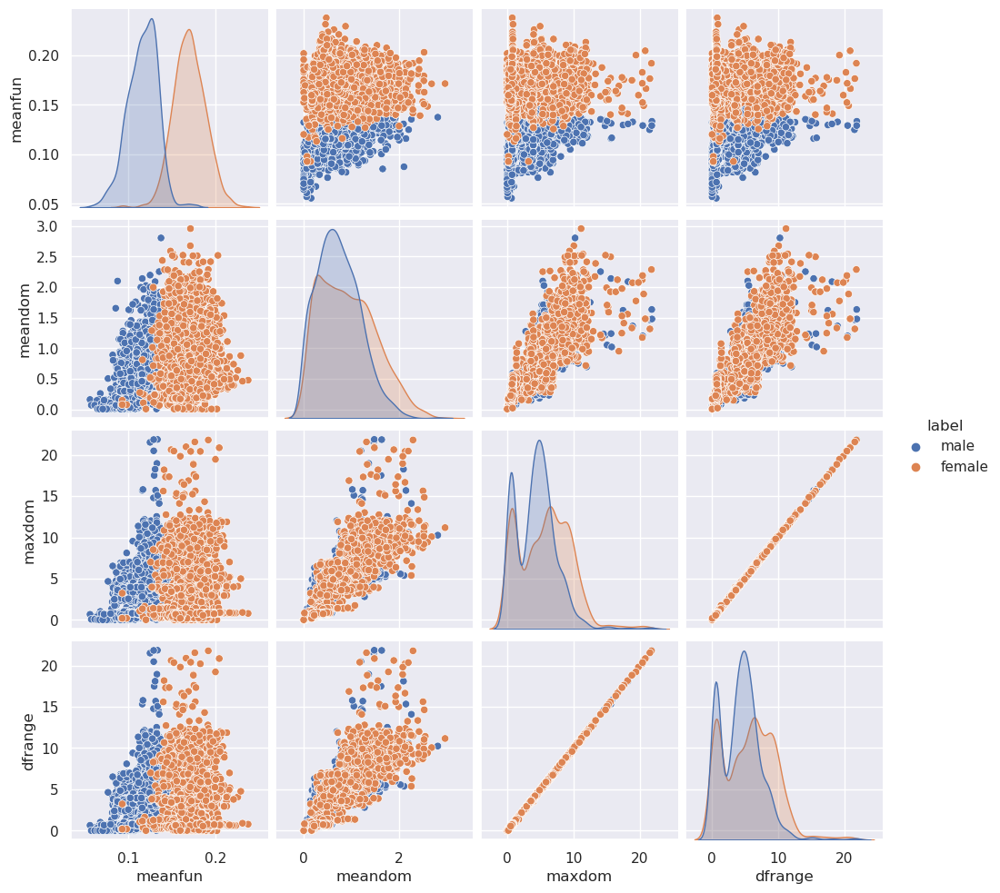

In [87]:
sns.set(style="darkgrid") #whitegrid, ticks
sns.pairplot(voice_df_keypred, hue="label")

<span style="font-family:Georgia; font-size:20px; color:#333">Future Studies and Application</span>

- <span style="font-family:Georgia; font-size:12px; color:#333;">1. **Advanced Feature Engineering:** Delving deeper into the acoustic properties of voice data and exploring more intricate feature engineering techniques tailored to specific characteristics could unlock additional insights and enhance model performance.</span>

- <span style="font-family:Georgia; font-size:12px; color:#333;">2. **Exploration of Modern Signal Processing:** Investigating modern signal processing techniques, such as deep learning architectures or time-frequency analysis methods, could offer new perspectives on voice analysis and contribute to more accurate and nuanced classification models.</span>

- <span style="font-family:Georgia; font-size:12px; color:#333;">3. **Expansion to Individual Voice Recognition:** Extending the scope of the study beyond gender classification to individual voice recognition opens up new possibilities for personalized applications, such as voice-controlled systems and authentication mechanisms. This expansion would require a more granular analysis of unique vocal characteristics and the development of tailored recognition models.</span>

- <span style="font-family:Georgia; font-size:12px; color:#333;">4. **In-depth Analysis of Acoustic Properties:** Conducting in-depth analyses of additional acoustic properties beyond those explored in this study could provide a more comprehensive understanding of voice characteristics and improve the robustness of classification models. Exploring factors such as pitch modulation, harmonics, and temporal dynamics could offer valuable insights into the intricacies of voice patterns.</span>


<span style="font-family:Georgia; font-size:16px; color:#333;">References</span>

- Araya-Salas, M. (2020). *spectro_analysis: Wrapper for Spectrogram Analysis*. In *warbleR: Extract and Analyze Acoustic Features of Animal Calls*. Retrieved from [https://marce10.github.io/warbleR/reference/spectro_analysis.html](https://marce10.github.io/warbleR/reference/spectro_analysis.html)

- Araya-Salas, M. (2020). *Intro to warbleR*. In *warbleR: Extract and Analyze Acoustic Features of Animal Calls* (pp. 1-9). Retrieved from [https://cran.r-project.org/web/packages/warbleR/vignettes/Intro_to_warbleR.html#warbleR_functions_and_the_workflow_of_analysis_in_bioacoustics](https://cran.r-project.org/web/packages/warbleR/vignettes/Intro_to_warbleR.html#warbleR_functions_and_the_workflow_of_analysis_in_bioacoustics)

- Primary Objects. (n.d.). *Voicegender*. Kaggle. Retrieved from [https://www.kaggle.com/datasets/primaryobjects/voicegender](https://www.kaggle.com/datasets/primaryobjects/voicegender)
<span style="font-family:Georgia; font-size:12px; color:#333;">References</span>